In [152]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import warnings 
warnings.filterwarnings("ignore")
pd.set_option("display.max_row",None)
pd.set_option("display.max_columns",None)
     

In [103]:
taxi=pd.read_csv("TaxiFare.csv")

In [104]:
taxi.head()

,unique_id,amount,date_time_of_pickup,longitude_of_pickup,latitude_of_pickup,longitude_of_dropoff,latitude_of_dropoff,no_of_passenger
0,26:21.0,4.5,2009-06-15 17:26:21 UTC,-73.844311,40.721319,-73.841610,40.712278,1
1,52:16.0,16.9,2010-01-05 16:52:16 UTC,-74.016048,40.711303,-73.979268,40.782004,1
2,35:00.0,5.7,2011-08-18 00:35:00 UTC,-73.982738,40.761270,-73.991242,40.750562,2
3,30:42.0,7.7,2012-04-21 04:30:42 UTC,-73.987130,40.733143,-73.991567,40.758092,1
4,51:00.0,5.3,2010-03-09 07:51:00 UTC,-73.968095,40.768008,-73.956655,40.783762,1


In [105]:
taxi.isnull().sum()

unique_id               0
amount                  0
date_time_of_pickup     0
longitude_of_pickup     0
latitude_of_pickup      0
longitude_of_dropoff    0
latitude_of_dropoff     0
no_of_passenger         0
dtype: int64

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b483610>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b483b50>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b483370>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b4b40d0>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b4b4370>],
 'means': []}

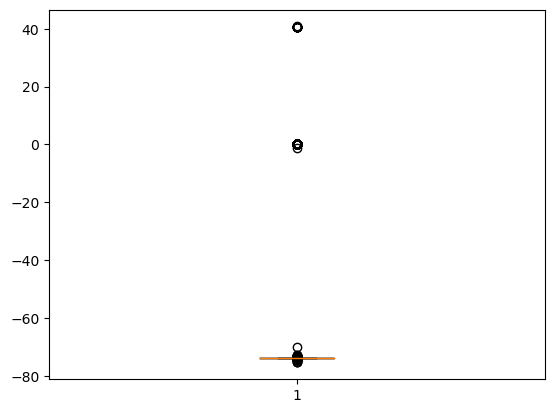

In [106]:
plt.boxplot(taxi.longitude_of_pickup)

In [107]:
q3=taxi["longitude_of_pickup"].quantile(0.75)
q1=taxi["longitude_of_pickup"].quantile(0.25)
iqr= q3-q1

In [108]:
upper_limt=q1+(iqr*1.5)
lower_limt=q3-(iqr*1.5)

In [109]:
upper_limt

-73.95469100000001

In [110]:
lower_limt

-74.004519

In [111]:
taxi["longitude_of_pickup"]=np.where(taxi["longitude_of_pickup"] >= upper_limt,upper_limt,np.where(taxi["longitude_of_pickup"] <= lower_limt,lower_limt,taxi["longitude_of_pickup"]))

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b4fb460>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b4fb9a0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b4fb2e0>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b4fbee0>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b5301c0>],
 'means': []}

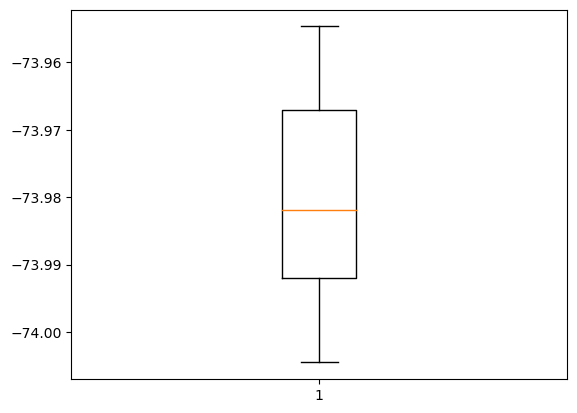

In [112]:
plt.boxplot(taxi.longitude_of_pickup)

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b579660>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b579ba0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b5793c0>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b57a0e0>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b57a380>],
 'means': []}

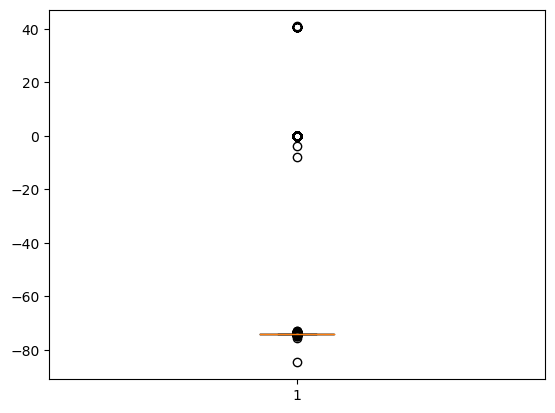

In [113]:
plt.boxplot(taxi.longitude_of_dropoff)

In [114]:
q3=taxi["longitude_of_dropoff"].quantile(0.75)
q1=taxi["longitude_of_dropoff"].quantile(0.25)
iqr= q3-q1

In [115]:
upper_limt=q1+(iqr*1.5)
lower_limt=q3-(iqr*1.5)

In [116]:
taxi["longitude_of_dropoff"]=np.where(taxi["longitude_of_dropoff"] >= upper_limt,upper_limt,np.where(taxi["longitude_of_dropoff"] <= lower_limt,lower_limt,taxi["longitude_of_dropoff"]))

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b791300>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b791840>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b791060>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b791d80>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b792020>],
 'means': []}

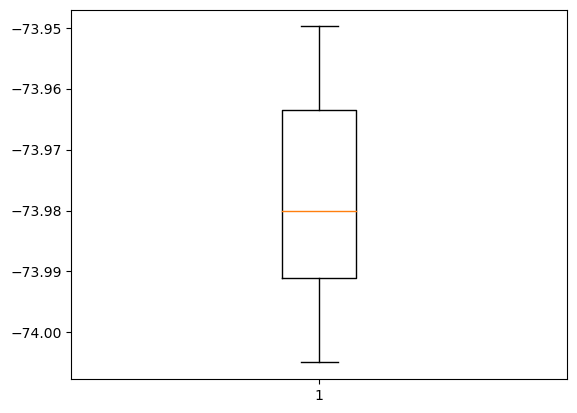

In [117]:
plt.boxplot(taxi.longitude_of_dropoff)

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b818070>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b8185b0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b7dfd90>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b818af0>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b818d90>],
 'means': []}

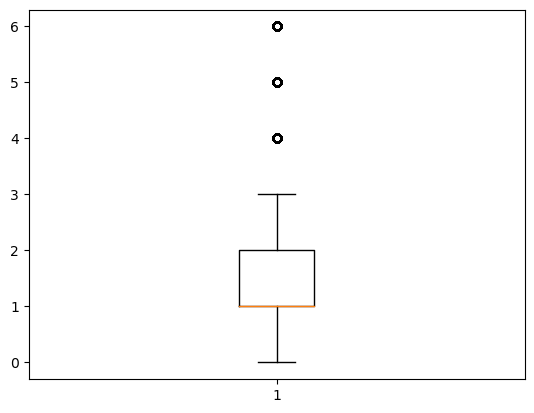

In [118]:
plt.boxplot(taxi.no_of_passenger)

In [119]:
q3=taxi["no_of_passenger"].quantile(0.75)
q1=taxi["no_of_passenger"].quantile(0.25)
iqr= q3-q1

In [120]:
upper_limt=q1+(iqr*1.5)
lower_limt=q3-(iqr*1.5)

In [121]:
taxi["no_of_passenger"]=np.where(taxi["no_of_passenger"] >= upper_limt,upper_limt,np.where(taxi["no_of_passenger"] <= lower_limt,lower_limt,taxi["no_of_passenger"]))

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b5bfa60>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b5bffa0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b5bf7c0>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b5f4520>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b5f47c0>],
 'means': []}

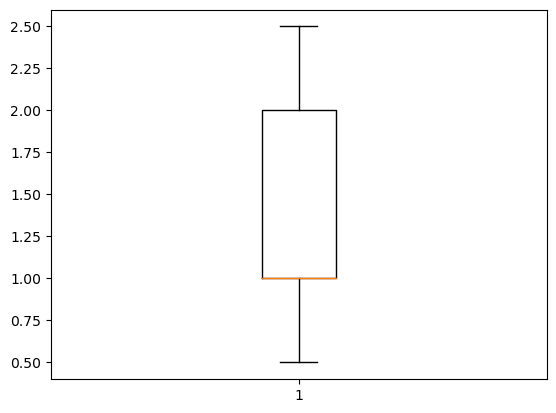

In [122]:
plt.boxplot(taxi.no_of_passenger)

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b664580>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b664ac0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b664400>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b665000>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b6652a0>],
 'means': []}

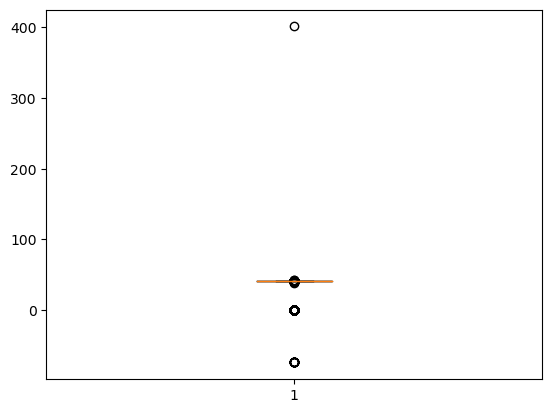

In [123]:
plt.boxplot(taxi.latitude_of_pickup)

In [124]:
q3=taxi["latitude_of_pickup"].quantile(0.75)
q1=taxi["latitude_of_pickup"].quantile(0.25)
iqr= q3-q1

In [125]:
upper_limt=q1+(iqr*1.5)
lower_limt=q3-(iqr*1.5)

In [126]:
upper_limt

40.78360074999999

In [127]:
lower_limt

40.718639749999994

In [128]:
taxi["latitude_of_pickup"]=np.where(taxi["latitude_of_pickup"] >= upper_limt,upper_limt,np.where(taxi["latitude_of_pickup"] <= lower_limt,lower_limt,taxi["latitude_of_pickup"]))

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b84e200>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b84e740>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b84df60>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b84ec80>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b84ef20>],
 'means': []}

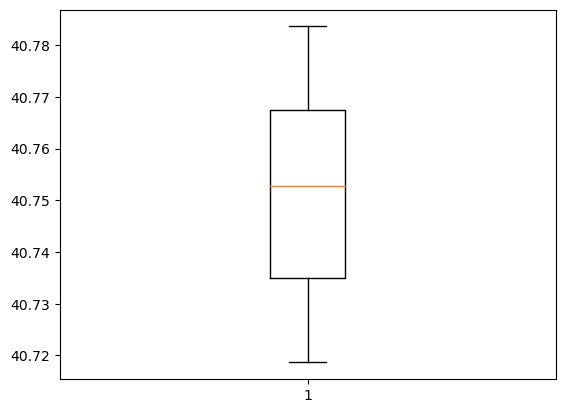

In [129]:
plt.boxplot(taxi.latitude_of_pickup)

{'whiskers': [<matplotlib.lines.Line2D at 0x18b2b8d17b0>,
 'caps': [<matplotlib.lines.Line2D at 0x18b2b8d1cf0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b2b8d1570>],
 'medians': [<matplotlib.lines.Line2D at 0x18b2b8d2230>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b2b8d24d0>],
 'means': []}

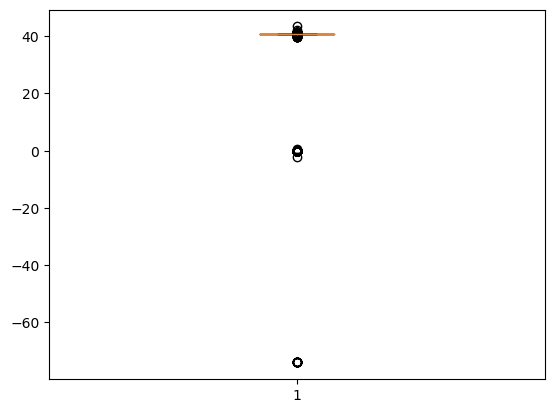

In [130]:
plt.boxplot(taxi.latitude_of_dropoff)

In [131]:
q3=taxi["latitude_of_dropoff"].quantile(0.75)
q1=taxi["latitude_of_dropoff"].quantile(0.25)
iqr= q3-q1

In [132]:
upper_limt=q1+(iqr*1.5)
lower_limt=q3-(iqr*1.5)

In [133]:
taxi["latitude_of_dropoff"]=np.where(taxi["latitude_of_dropoff"] >= upper_limt,upper_limt,np.where(taxi["latitude_of_dropoff"] <= lower_limt,lower_limt,taxi["latitude_of_dropoff"]))

{'whiskers': [<matplotlib.lines.Line2D at 0x18b47420a90>,
 'caps': [<matplotlib.lines.Line2D at 0x18b47420fd0>,
 'boxes': [<matplotlib.lines.Line2D at 0x18b474207f0>],
 'medians': [<matplotlib.lines.Line2D at 0x18b47421510>],
 'fliers': [<matplotlib.lines.Line2D at 0x18b474217b0>],
 'means': []}

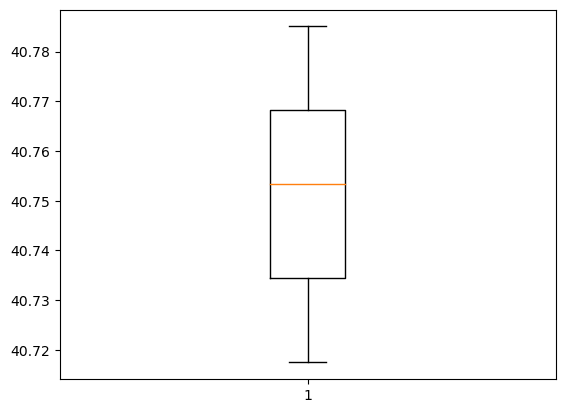

In [134]:
plt.boxplot(taxi.latitude_of_dropoff)

In [135]:
taxi.unique_id.unique()

array(['26:21.0', '52:16.0', '35:00.0', ..., '38:13.0', '04:12.0',
       '53:22.0'], dtype=object)

In [136]:
taxi.date_time_of_pickup.unique()

array(['2009-06-15 17:26:21 UTC', '2010-01-05 16:52:16 UTC',
       '2011-08-18 00:35:00 UTC', ..., '2011-01-30 04:53:00 UTC',
       '2012-11-06 07:09:00 UTC', '2010-01-13 08:13:14 UTC'], dtype=object)

In [137]:
taxi.drop(["unique_id","date_time_of_pickup"],axis=1,inplace=True)

In [138]:
dummie = pd.get_dummies(taxi)

In [139]:
dummie.head()

,amount,longitude_of_pickup,latitude_of_pickup,longitude_of_dropoff,latitude_of_dropoff,no_of_passenger
0,4.5,-73.954691,40.721319,-73.949800,40.717474,1.0
1,16.9,-74.004519,40.718640,-73.979268,40.782004,1.0
2,5.7,-73.982738,40.761270,-73.991242,40.750562,2.0
3,7.7,-73.987130,40.733143,-73.991567,40.758092,1.0
4,5.3,-73.968095,40.768008,-73.956655,40.783762,1.0


In [140]:
x=dummie.drop(["amount"],axis=1)

In [141]:
y=dummie.amount

In [142]:
trainx,testx,trainy,testy=train_test_split(x,y,test_size=0.2,random_state=42)

# RandomForestRegressor

In [143]:
rf=RandomForestRegressor(random_state=0)
rf.fit(trainx,trainy)

RandomForestRegressor(random_state=0)

In [144]:
rf.predict(testx)

array([ 9.495 , 31.7564,  4.878 , ...,  9.48  , 22.0876,  7.7791])

In [145]:
d=rf.score(testx,testy)

In [146]:
d

0.5009092137162034

In [147]:
rme3=sqrt(mean_squared_error(testy,rf.predict(testx),squared=False))

In [148]:
rme3

2.609946854239275

Text(0, 0.5, 'latitude_of_dropoff')

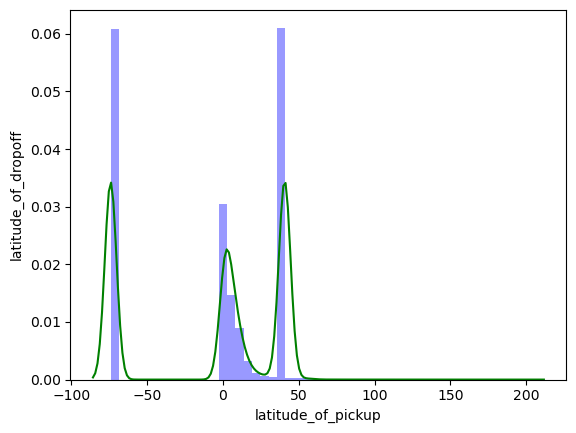

In [160]:

taxi
sns.distplot(taxi, kde=True, bins=50, color="green", hist_kws={"facecolor": "blue"})
plt.xlabel("latitude_of_pickup")
plt.ylabel("latitude_of_dropoff")

<Axes: xlabel='no_of_passenger', ylabel='Density'>

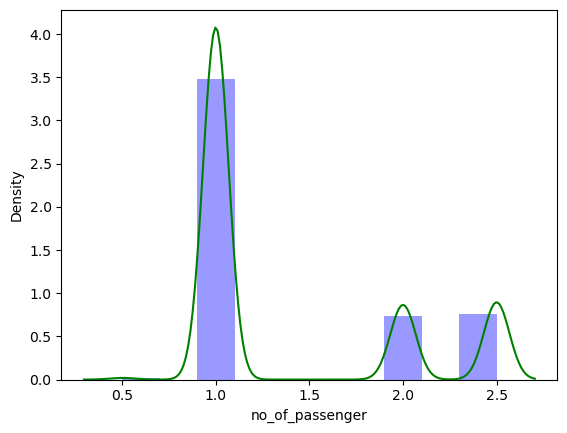

In [163]:
sns.distplot(taxi["no_of_passenger"], kde=True, bins=10, color="green", hist_kws={"facecolor": "blue"})

In [172]:
##majority of people travels individually
taxi

,amount,longitude_of_pickup,latitude_of_pickup,longitude_of_dropoff,latitude_of_dropoff,no_of_passenger
0,4.50,-73.954691,40.721319,-73.949800,40.717474,1.0
1,16.90,-74.004519,40.718640,-73.979268,40.782004,1.0
2,5.70,-73.982738,40.761270,-73.991242,40.750562,2.0
3,7.70,-73.987130,40.733143,-73.991567,40.758092,1.0
4,5.30,-73.968095,40.768008,-73.956655,40.783762,1.0
5,12.10,-74.000964,40.731630,-73.972892,40.758233,1.0
6,7.50,-73.980002,40.751662,-73.973802,40.764842,1.0
7,16.50,-73.954691,40.774138,-73.990095,40.751048,1.0
8,9.00,-74.004519,40.726713,-73.993078,40.731628,1.0
9,8.90,-73.980658,40.733873,-73.991540,40.758138,2.0


In [170]:
sns.scatterplot(x="longitude_of_pickup",y="latitude_of_pickup",hue="amount",data="taxi")

ValueError: Could not interpret value `longitude_of_pickup` for parameter `x`